In [14]:
import numpy as np
import torch
import data_making.dataset as dataset
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import results
import os
import trimesh
from mesh_to_sdf import sample_sdf_near_surface
import data
from utils import utils
import meshplot as mp
from data_making.extract_data import *
import argparse

### PartNet Mobility extracted with my functions

In [ ]:
data_set = dataset.SDFDataset()

In [ ]:
sdf = np.array(data_set[:][1].view(-1))
plt.hist(sdf, bins=40)
plt.show()

### PartNet Mobility with Marian's function

In [72]:
objs_dict = np.load(os.path.join(os.path.dirname(results.__file__), 'objs_dict.npy'), allow_pickle=True).item()

In [89]:
obj = objs_dict['102763']
verts = obj['verts']
faces = obj['faces']

In [90]:
mesh = trimesh.Trimesh(verts, faces)
points, sdf = sample_sdf_near_surface(mesh, number_of_points=50000, sign_method='depth')

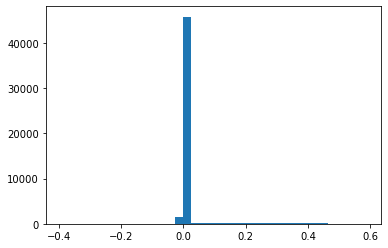

In [91]:
plt.hist(sdf, bins=40)
plt.show()

In [97]:
negative_indexes = np.where(sdf < 0)
positive_indexes = np.where(sdf > 0.001)

negative_sdf_points = points[negative_indexes]
positive_sdf_points = points[positive_indexes]

In [98]:
fig = go.Figure(
    [
        go.Scatter3d(x=negative_sdf_points[:, 0], 
             y=negative_sdf_points[:, 1],
             z=negative_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2)),
        go.Scatter3d(x=positive_sdf_points[:, 0], 
             y=positive_sdf_points[:, 1],
             z=positive_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2, color='orange')
            )
    ]
)
fig.show()

### ShapeNet with my function

In [62]:
obj_path = os.path.join(os.path.dirname(data.__file__), 'shapenet_obj', '1b29de0b8be4b18733d25da891be74b8.obj' )
mesh = utils._as_mesh(trimesh.load(obj_path))   # for some reason, they are 2

In [63]:
mp.plot(mesh.vertices, mesh.faces)

/Users/ri21540/miniforge3/envs/active_touch/lib/python3.8/site-packages/jupyter_client/session.py:716: UserWarning:

Message serialization failed with:
Out of range float values are not JSON compliant
Supporting this message is deprecated in jupyter-client 7, please make sure your message is JSON-compliant

/Users/ri21540/miniforge3/envs/active_touch/lib/python3.8/site-packages/traittypes/traittypes.py:97: UserWarning:

Given trait value dtype "float32" does not match required type "float64". A coerced copy has been created.

/Users/ri21540/miniforge3/envs/active_touch/lib/python3.8/site-packages/traittypes/traittypes.py:97: UserWarning:

Given trait value dtype "uint32" does not match required type "float64". A coerced copy has been created.



Renderer(camera=PerspectiveCamera(children=(DirectionalLight(color='white', intensity=0.6, position=(-74.32485…

In [64]:
obj_idx = 0
#trimesh.repair.fix_inversion(mesh)
objs_dict = {0: {'verts': np.asarray(mesh.vertices), 'faces': np.asarray(mesh.faces)}}

class Args:
  num_samples_on_surface = 5000
  num_samples_far_surface = 5000

args=Args()

samples_dict = dict()
samples_dict[obj_idx] = dict()
samples_dict[obj_idx]['samples'] = sample(objs_dict[obj_idx], args)
samples_dict[obj_idx]['sdf'] = compute_sdf(objs_dict[obj_idx]['verts'], objs_dict[obj_idx]['faces'], samples_dict[obj_idx]['samples'])
samples_dict[obj_idx]['latent_class'] = np.array([obj_idx], dtype=np.int32)
samples_dict[obj_idx]['samples_latent_class'] = combine_sample_latent(samples_dict[obj_idx]['samples'], samples_dict[obj_idx]['latent_class'])


In [66]:
def _debug_plot(samples, dist=True):
    points = samples['samples']
    sdfs = samples['sdf']
    inner = points[sdfs>0]
    outer = points[sdfs<0]

    fig = go.Figure(
        [
            go.Scatter3d(x=inner[:, 0], y=inner[:, 1],z=inner[:, 2], mode='markers', marker=dict(size=2)),
            go.Scatter3d(x=outer[:, 0], y=outer[:, 1],z=outer[:, 2], mode='markers', marker=dict(size=2))
        ]
    )
    fig.show()

_debug_plot(samples_dict[obj_idx]) 


In [67]:
points, sdf = sample_sdf_near_surface(mesh, sign_method='depth', number_of_points=100000)

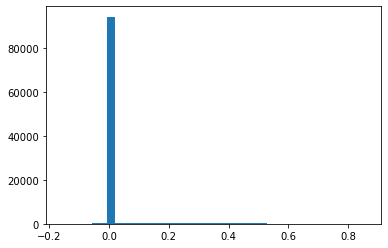

In [68]:
plt.hist(sdf, bins=40)
plt.show()

In [69]:
negative_indexes = np.where(sdf < 0)
positive_indexes = np.where(sdf > 0)

negative_sdf_points = points[negative_indexes]
positive_sdf_points = points[positive_indexes]

negative_sdf = sdf[negative_indexes]
positive_sdf = sdf[positive_indexes]

In [70]:
fig = go.Figure(
    [
        go.Scatter3d(x=negative_sdf_points[:, 0], 
             y=negative_sdf_points[:, 1],
             z=negative_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2, color='orange')),
        go.Scatter3d(x=positive_sdf_points[:, 0], 
             y=positive_sdf_points[:, 1],
             z=positive_sdf_points[:, 2], 
             mode='markers', marker=dict(size=2, color='blue')
            )
    ]
)
fig.show()

In [71]:
np.amin(sdf)

-0.15934588